<h1>Chapter 12: The 2D Ising Model<h1>

There is a lot of useful input in this notebook, but some of the animated cells take a while to run.  Do NOT use "run all" for this notebook, rather go through in order and try to understand what each cell is doing.

The headings below match the sections from Schrier Ch. 12 and the inputs are meant to recapitulate in Python what he did originally in Mathematica.

In [1]:
import numpy as np
from matplotlib import pyplot as plt
import matplotlib as mpl
import sympy as sy

<h2>12.1 Description of the Model<h2>

<h2>12.2 Computational Implementation<h2>

<h3>12.2.1 Representing spin configurations as lists<h3>

(the lists are numpy arrays here)

In [2]:
example = np.array([[1,2],[3,4]])

In [3]:
print(example)

[[1 2]
 [3 4]]


Here is how to make graphical versions of arrays using a color map (here it's grayscale) for the numbers that appear in the arrays: this will be useful for making graphical representations of the Ising model.

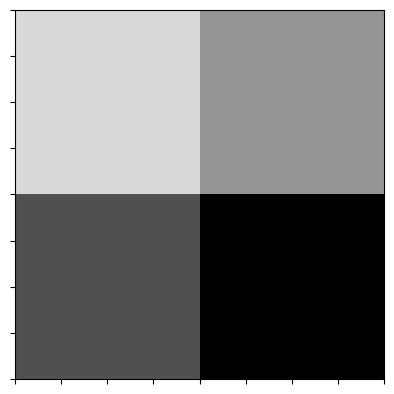

In [4]:
def arrayPlot(array,vmin=0,vmax=None):
    """A python version of the ArrayPlot[] function in Mathematica"""
    fig, ax = plt.subplots()
    ax.set_yticklabels([])
    ax.set_xticklabels([])
    ax.imshow(array,cmap='Greys',vmin=vmin,vmax=vmax)
    plt.show()

arrayPlot(example)

In [5]:
example[0] #remember that python starts counting from zero, not one.

array([1, 2])

In [6]:
example[0,0] #remember that python starts counting from zero, not one.

1

In [7]:
example[0,1] #remember that python starts counting from zero, not one.

2

In [8]:
row, col = np.random.randint(0,2,2) #this selects two random integers between 0 and 1
#(arguments np.random.randint are low limit, high limit exclusive, amount randomly selected)

In [9]:
example[row,col] #selects a random element of the array that is indexed by the random numbers from above

3

<h3>12.2.2 Generating initial configurations<h3>

In [10]:
nSize = 6
allUpConfig = np.array([[1 for i in range(nSize)] for j in range(nSize)])
# a reproduction of what Table[] does in Mathematica
print(allUpConfig)

[[1 1 1 1 1 1]
 [1 1 1 1 1 1]
 [1 1 1 1 1 1]
 [1 1 1 1 1 1]
 [1 1 1 1 1 1]
 [1 1 1 1 1 1]]


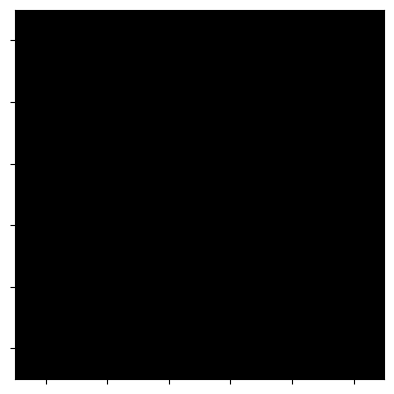

In [11]:
arrayPlot(allUpConfig,-1,1)

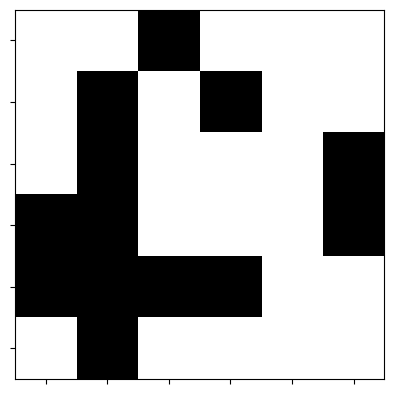

In [12]:
randomConfig = np.array([[(-1)**np.random.randint(2) for i in range(nSize)] for j in range(nSize)])
# a reproduction of what Table[] does in Mathematica
arrayPlot(randomConfig,-1,1)

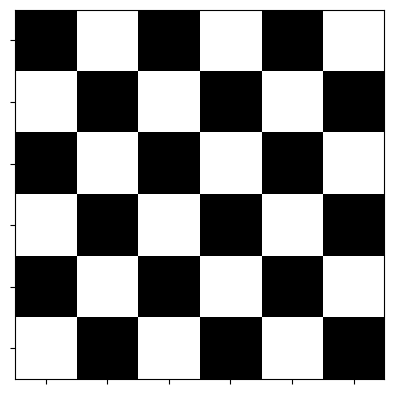

In [13]:
checkerboardConfig = np.array([[(-1)**(row+col) for row in range(nSize)] for col in range(nSize)])
arrayPlot(checkerboardConfig,-1,1)

<h3>12.2.3 Computing properties: Magnetization<h3>

The "Magnetization" in an Ising model is basically a count of how many different kinds of state there are: the original Ising lattice model just had spins up and spins down, which add up to some net "magnetization" across the model.

In [14]:
def netMagnetization(config):
  """Python version of the first netMagnetization[] function Schrier writes"""
  total = 0
  for row in config:
      for element in row:
          total+= element
  return total

In [15]:
netMagnetization(allUpConfig)

36

In [16]:
netMagnetization(checkerboardConfig)

0

In [17]:
def netMagnetization(config):
    """Python version of the second netMagnetization[] function Schrier writes
    automatically includes summation over all levels of the array"""
    return np.sum(config)

In [18]:
(netMagnetization(allUpConfig),netMagnetization(checkerboardConfig))

(36, 0)

In [19]:
def netMagnetizationPerSpin(config):
  """Python version of net magnetization function"""
  return netMagnetization(config)/len(config)**2

In [20]:
(netMagnetizationPerSpin(allUpConfig),netMagnetizationPerSpin(checkerboardConfig))

(1.0, 0.0)

In [21]:
netMagnetizationPerSpin(randomConfig) #try this for a few randomConfig to see whether it changes; it should

-0.2777777777777778

<h3>12.2.4 Computing properties: Energy<h3>

The total energy of the Ising model has to be counted step by step across the whole array and depends on rules that can vary: here the parameters "J" and "B" tell you how strongly the spins interact with each other and how big the difference in energy between the two states is, respectively. The energy rules can change based on those two parameters and also based on how the system is defined (i.e. whether it has walls or not).

In [22]:
def energyIsing2D(config,J,B):
    """
    Function for calculating the energy of an Ising Model.
    Requires a config (the Ising Model in question), a value of J (interaction parameter)
    and a value for B (external field parameter)
    """
    energyB,energyJ = 0,0 # Initializes local variables
    for row in range(len(config)): # Loop over rows
        for col in range(len(config)): # Simultaneously loop over columns
            energyB += B*config[row,col]
            if row>0: # Up
                energyJ += J*config[row-1,col]*config[row,col]
            if row<len(config)-1: # Down
                energyJ += J*config[row+1,col]*config[row,col]
            if col>0: # Left
                energyJ += J*config[row,col-1]*config[row,col]
            if col<len(config)-1: # Right
                energyJ += J*config[row,col+1]*config[row,col]
    return energyB + energyJ/2 # Removes double counting

In [23]:
energyIsing2D(checkerboardConfig,1,0)

-60.0

In [24]:
energyIsing2D(checkerboardConfig,-1,0)

60.0

In [25]:
energyIsing2D(allUpConfig,0,1)

36.0

In [26]:
def energyPerSpin(config,J,B,energyFunction):
    """"calculate the energy per spin based on a
    particular ising model configuation "config",
    an interaction parameter "J"
    an external field parameter "B"
    and a function for calculating the energy"""
    return energyFunction(config,J,B)/len(config)**2

In [27]:
(energyPerSpin(checkerboardConfig,1,0,energyIsing2D),
energyPerSpin(checkerboardConfig,-1,0,energyIsing2D),
energyPerSpin(allUpConfig,0,1,energyIsing2D))

(-1.6666666666666667, 1.6666666666666667, 1.0)

<h2>12.3 Metropolis Monte Carlo Simulation<h2>

<h3>12.3.1 Basic implementations<h3>

In [28]:
def MCstep(kT,J,B,config):
    """functions for taking a single Monte Carlo step"""
    newConfig = config.copy() #def local variables
    row,col = np.random.randint(0,len(config),2) #pick random spin

    #calculate the energy **before the change**
    Estart = config[row,col]*B
    if row>0: # Up
        Estart += J*config[row-1,col]*config[row,col]
    if row<len(config)-1: # Down
        Estart += J*config[row+1,col]*config[row,col]
    if col>0: # Left
        Estart += J*config[row,col-1]*config[row,col]
    if col<len(config)-1: # Right
        Estart += J*config[row,col+1]*config[row,col]

    #a single spin flip multiplies the local energy by -1
    Eend = -Estart

    if Eend < Estart: #did energy decrease?
      newConfig[row,col] *= -1 # Then flip the spin
    else:
      if np.random.random() <= np.exp(-(Eend-Estart)/kT): # If a random number is less than the probability
        newConfig[row,col] *= -1 # Then flip the spin

    return newConfig

In [29]:
def runMCmovie(kT,J,B,MCstepFunction, ax):
    """a python version of the runMCmovie function"""
    nSize = 10
    checkerboardConfig = np.array([[(-1)**(row+col) for row in range(nSize)] for col in range(nSize)])
    config = checkerboardConfig.copy()
    trajectory = []
    for i in range(1500):
        config = MCstepFunction(kT,J,B,config)
        ax.set_yticklabels([])
        ax.set_xticklabels([])
        arrayplot = [ax.imshow(config,cmap='Greys',
                               vmin=-1,vmax=1, animated=True)]
        print(arrayplot)
        trajectory.append(arrayplot)
    return trajectory #a list of arrayplot outputs

In [30]:
from matplotlib import rc
rc('animation', html='jshtml')

In [31]:
%matplotlib notebook
import matplotlib.animation as animation

fig1, ax = plt.subplots()
images = runMCmovie(10,-1,0,MCstep, ax)

ani = animation.ArtistAnimation(fig1, images, interval=1000/50, blit=True)

#ignore the error message

<IPython.core.display.Javascript object>

In [32]:
ani #heads up this can take up to 5 minutes
#click the right arrow button below the frame to run the movie

In [ ]:
def runMC(kT, J, B, nEquil, nDataCol, sampleInterval, config, MCstepFunction, energyFunction):
    """function to run the Ising model MC simulation and collectsamples"""
    Esamples = []
    Msamples = []
    newConfig = config.copy()
    for i in range(nEquil):
        newConfig = MCstepFunction(kT, J, B, newConfig)
    for i in range(nDataCol):
        newConfig = MCstepFunction(kT, J, B, newConfig)
        if i % sampleInterval == 0:
            Esamples.append(energyFunction(newConfig,J,B))
            Msamples.append(abs(netMagnetizationPerSpin(newConfig)))
    Esamples = np.array(Esamples)
    Msamples = np.array(Msamples)
    return [Esamples.mean()/len(config)**2, # Mean Energy per spin
           Esamples.var()/(len(config)**2*kT**2), # Heat Capacity per spin
           Msamples.mean(), # Average net magnetization per spin
           newConfig] # The Final configuration

In [ ]:
EPerSpin,heatCap,netMagPerSpin,finalConfig = runMC(1,-1,0,10000,200000,1000,checkerboardConfig,MCstep,energyIsing2D)

In [ ]:
print('The average energy is:', EPerSpin)
print('The heat capacity is:', heatCap)
print('The net magnetization is:', netMagPerSpin)

The average energy is: -1.6466666666666667
The heat capacity is: 0.1267111111111111
The net magnetization is: 0.9894444444444446


In [ ]:
arrayPlot(finalConfig,-1,1)

<IPython.core.display.Javascript object>

In [ ]:
finalConfig

array([[-1, -1, -1, -1, -1, -1],
       [-1, -1, -1, -1, -1, -1],
       [-1, -1, -1, -1, -1, -1],
       [-1, -1, -1, -1, -1, -1],
       [-1, -1, -1, -1, -1, -1],
       [-1, -1, -1, -1, -1, -1]])

<h2>12.4 Generalization<h2>

<h3>12.4.1 Periodic boundary conditions<h3>

In [ ]:
def energyIsing2DPBC(config, J, B):
    """energy of an Ising model with Periodic Boundary Conditions"""
    energyB = 0
    energyJ = 0
    for row in range(len(config)):
        for col in range(len(config)):
            energyB += B*config[row,col]
            if row>0: # Up
                energyJ += J*config[row-1,col]*config[row,col] # Interior
            else:
                energyJ += J*config[len(config)-1,col]*config[row,col] # Periodic boundary conditions
            if row<len(config)-1: # Down
                energyJ += J*config[row+1,col]*config[row,col] # Interior
            else:
                energyJ += J*config[0,col]*config[row,col] # Periodic boundary conditions
            if col>0: # Left
                energyJ += J*config[row,col-1]*config[row,col] # Interior
            else:
                energyJ += J*config[row,len(config)-1]*config[row,col] # Periodic boundary conditions
            if col<len(config)-1: # right
                energyJ += J*config[row,col+1]*config[row,col] # Interior
            else:
                energyJ += J*config[row,0]*config[row,col] # Periodic boundary conditions
    return energyB+(energyJ/2) # Remove double counting and return final result

In [ ]:
(energyPerSpin(checkerboardConfig,1,0,energyIsing2DPBC),
energyPerSpin(checkerboardConfig,-1,0,energyIsing2DPBC),
energyPerSpin(allUpConfig,0,1,energyIsing2DPBC))

(-2.0, 2.0, 1.0)

In [ ]:
def MCstepPBC(kT,J,B,config):
    """MC step for Periodic Ising Model"""
    newConfig = config.copy()
    row,col = np.random.randint(0,len(config),2)
    Estart = config[row,col]*B
    if row>0: # Up
        Estart += J*config[row-1,col]*config[row,col] # Interior
    else:
        Estart += J*config[len(config)-1,col]*config[row,col] # Periodic boundary conditions
    if row<len(config)-1: # Down
        Estart += J*config[row+1,col]*config[row,col] # Interior
    else:
        Estart += J*config[0,col]*config[row,col] # Periodic boundary conditions
    if col>0: # Left
        Estart += J*config[row,col-1]*config[row,col] # Interior
    else:
        Estart += J*config[row,len(config)-1]*config[row,col] # Periodic boundary conditions
    if col<len(config)-1: # right
        Estart += J*config[row,col+1]*config[row,col] # Interior
    else:
        Estart += J*config[row,0]*config[row,col] # Periodic boundary conditions
    Eend = -Estart

    if Eend < Estart: #did energy decrease?
      newConfig[row,col] *= -1 # Then flip the spin
    else:
      if np.random.random() <= np.exp(-(Eend-Estart)/kT): # If a random number is less than the probability
        newConfig[row,col] *= -1 # Then flip the spin

    return newConfig # Return the potentially altered array

In [ ]:
EPerSpin,heatCap,netMagPerSpin,finalConfig=runMC(10,-1,0,10000,200000,1000,checkerboardConfig,MCstepPBC,energyIsing2DPBC)

In [ ]:
print('The average energy is:', EPerSpin)
print('The heat capacity is:', heatCap)
print('The net magnetization is:', netMagPerSpin)

The average energy is: -0.22444444444444445
The heat capacity is: 0.02146488888888889
The net magnetization is: 0.16083333333333336


In [ ]:
arrayPlot(finalConfig) # Show final configuration of simulation using periodic boundary conditions

<IPython.core.display.Javascript object>

In [ ]:
def MCstepConstN(kT,J,B,config):
    newConfig=config.copy()
    configDidChange=False
    rowA,colA,rowB,colB=np.random.randint(1,len(config),4)

    spinA = config[rowA,colA]
    spinB = config[rowB,colB]

    if spinA != spinB: # Only do MC procedure if something charged
        newConfig[rowA,colA] = spinB # First, interchange the spins
        newConfig[rowB,colB] = spinA
        Estart = energyIsing2D(config,J,B) # Get configuration energies
        Eend = energyIsing2D(newConfig,J,B)
        if Eend<Estart or np.random.random()<np.exp(-(Eend-Estart)/kT): # Did the energy decrease or it randomly increases in energy?
            configDidChange = True
    if configDidChange: # Did the configuration change uring this process
        return newConfig # configDidChange==True, so return the new spin config
    return config # Otherwise, return the original spin configuration

In [ ]:
EPerSpin,heatCap,netMagPerSpin,finalConfig=runMC(10,-1,0,10000,200000,1000,checkerboardConfig,MCstepConstN,energyIsing2DPBC)

In [ ]:
print('The average energy is:', EPerSpin)
print('The heat capacity is:', heatCap)
print('The net magnetization is:', netMagPerSpin) # should be zero if constant N with equal numbers

The average energy is: 0.26
The heat capacity is: 0.01664177777777778
The net magnetization is: 0.0


In [ ]:
arrayPlot(finalConfig) # Final configuration of constant N simulation

<IPython.core.display.Javascript object>

Below is some code not in Schrier for making movies of simulations in the differently defined systems: this uses matplotlib animation tools to make the movies.

In [ ]:
#original
%matplotlib notebook
import matplotlib.animation as animation

fig1, ax = plt.subplots()
images = runMCmovie(10,-1,0,MCstepPBC, ax)

ani1 = animation.ArtistAnimation(fig1, images, interval=1000/50, blit=True)

<IPython.core.display.Javascript object>

In [ ]:
ani1 #takes a little computational time to actually make the movie

In [ ]:
#periodic boundary conditions

%matplotlib notebook
import matplotlib.animation as animation

fig2, ax = plt.subplots()
images = runMCmovie(10,-1,0,MCstepPBC, ax)

ani2 = animation.ArtistAnimation(fig2, images, interval=1000/50, blit=True)

<IPython.core.display.Javascript object>

In [ ]:
ani2 #again, takes a little while to show

In [ ]:
#constant particle number

%matplotlib notebook
import matplotlib.animation as animation

fig3, ax3 = plt.subplots()
images3 = runMCmovie(10,-1,0,MCstepConstN, ax3)
ani3 = animation.ArtistAnimation(fig3, images3, interval=1000/50, blit=True, repeat_delay=500)

<IPython.core.display.Javascript object>

In [ ]:
ani3

<h3>12.4.3 Further generalizations<h3>

<h2>12.5 Looking Forward<h2>

In [1]:

import numpy as np
from matplotlib import pyplot as plt
# import matplotlib as mpl
import sympy as sy
def arrayPlot(array,vmin=0,vmax=None):
    """A python version of the ArrayPlot[] function in Mathematica"""
    fig, ax = plt.subplots()
    ax.set_yticklabels([])
    ax.set_xticklabels([])
    ax.imshow(array,cmap='Greys',vmin=vmin,vmax=vmax)
    plt.show()
def netMagnetization(config):
  """Python version of the first netMagnetization[] function Schrier writes"""
  total = 0
  for row in config:
      for element in row:
          total+= element
  return total
def netMagnetization(config):
    """Python version of the second netMagnetization[] function Schrier writes
    automatically includes summation over all levels of the array"""
    return np.sum(config)
def netMagnetizationPerSpin(config):
  """Python version of net magnetization function"""
  return netMagnetization(config)/len(config)**2
def energyIsing2D(config,J,B):
    """
    Function for calculating the energy of an Ising Model.
    Requires a config (the Ising Model in question), a value of J (interaction parameter)
    and a value for B (external field parameter)
    """
    energyB,energyJ = 0,0 # Initializes local variables
    for row in range(len(config)): # Loop over rows
        for col in range(len(config)): # Simultaneously loop over columns
            energyB += B*config[row,col]
            if row>0: # Up
                energyJ += J*config[row-1,col]*config[row,col]
            if row<len(config)-1: # Down
                energyJ += J*config[row+1,col]*config[row,col]
            if col>0: # Left
                energyJ += J*config[row,col-1]*config[row,col]
            if col<len(config)-1: # Right
                energyJ += J*config[row,col+1]*config[row,col]
    return energyB + energyJ/2 # Removes double counting
def energyPerSpin(config,J,B,energyFunction):
    """"calculate the energy per spin based on a
    particular ising model configuation "config",
    an interaction parameter "J"
    an external field parameter "B"
    and a function for calculating the energy"""
    return energyFunction(config,J,B)/len(config)**2
def MCstep(kT,J,B,config):
    """functions for taking a single Monte Carlo step"""
    newConfig = config.copy() #def local variables
    row,col = np.random.randint(0,len(config),2) #pick random spin

    #calculate the energy **before the change**
    Estart = config[row,col]*B
    if row>0: # Up
        Estart += J*config[row-1,col]*config[row,col]
    if row<len(config)-1: # Down
        Estart += J*config[row+1,col]*config[row,col]
    if col>0: # Left
        Estart += J*config[row,col-1]*config[row,col]
    if col<len(config)-1: # Right
        Estart += J*config[row,col+1]*config[row,col]

    #a single spin flip multiplies the local energy by -1
    Eend = -Estart
    if Eend < Estart: #did energy decrease?
      newConfig[row,col] *= -1 # Then flip the spin
    else:
      if np.random.random() <= np.exp(-(Eend-Estart)/kT): # If a random number is less than the probability
        newConfig[row,col] *= -1 # Then flip the spin

    return newConfig

def runMCmovie(kT,J,B,MCstepFunction, ax):
    """a python version of the runMCmovie function"""
    nSize = 10
    checkerboardConfig = np.array([[(-1)**(row+col) for row in range(nSize)] for col in range(nSize)])
    config = checkerboardConfig.copy()
    trajectory = []
    for i in range(1500):
        config = MCstepFunction(kT,J,B,config)
        ax.set_yticklabels([])
        ax.set_xticklabels([])
        arrayplot = [ax.imshow(config,cmap='Greys',
                               vmin=-1,vmax=1, animated=True)]
        trajectory.append(MCstepFunction(kT,J,B,config))
        print(arrayplot)
    return trajectory #a list of arrayplot outputs
def runMC(kT, J, B, nEquil, nDataCol, sampleInterval, config, MCstepFunction, energyFunction):
    """function to run the Ising model MC simulation and collectsamples"""
    Esamples = []
    Msamples = []
    newConfig = config.copy()
    for i in range(nEquil):
        newConfig = MCstepFunction(kT, J, B, newConfig)
    for i in range(nDataCol):
        newConfig = MCstepFunction(kT, J, B, newConfig)
        if i % sampleInterval == 0:
            Esamples.append(energyFunction(newConfig,J,B))
            Msamples.append(abs(netMagnetizationPerSpin(newConfig)))
    Esamples = np.array(Esamples)
    Msamples = np.array(Msamples)
    return [Esamples.mean()/len(config)**2, # Mean Energy per spin
           Esamples.var()/(len(config)**2*kT**2), # Heat Capacity per spin
           Msamples.mean(), # Average net magnetization per spin
           newConfig] # The Final configuration
def MCstepPBC(kT,J,B,config):
    """MC step for Periodic Ising Model"""
    newConfig = config.copy()
    row,col = np.random.randint(0,len(config),2)
    Estart = config[row,col]*B
    if row>0: # Up
        Estart += J*config[row-1,col]*config[row,col] # Interior
    else:
        Estart += J*config[len(config)-1,col]*config[row,col] # Periodic boundary conditions
    if row<len(config)-1: # Down
        Estart += J*config[row+1,col]*config[row,col] # Interior
    else:
        Estart += J*config[0,col]*config[row,col] # Periodic boundary conditions
    if col>0: # Left
        Estart += J*config[row,col-1]*config[row,col] # Interior
    else:
        Estart += J*config[row,len(config)-1]*config[row,col] # Periodic boundary conditions
    if col<len(config)-1: # right
        Estart += J*config[row,col+1]*config[row,col] # Interior
    else:
        Estart += J*config[row,0]*config[row,col] # Periodic boundary conditions
    Eend = -Estart

    if Eend < Estart: #did energy decrease?
      newConfig[row,col] *= -1 # Then flip the spin
    else:
      if np.all(np.random.random() <= np.exp(-(Eend-Estart)/kT)): # If a random number is less than the probability
        newConfig[row,col] *= -1 # Then flip the spin

    return newConfig # Return the potentially altered array



In [ ]:
import numpy as np
from matplotlib import pyplot as plt

# Define functions for mean net magnetization, mean energy, and heat capacity
def mean_net_magnetization(config):
    return np.abs(netMagnetizationPerSpin(config))

def mean_energy(config, J, B):
    return energyPerSpin(config, J, B, energyIsing2D)

def heat_capacity(config, J, B, kT):
    return energyPerSpin(config, J, B, energyIsing2D)**2 / (kT**2)

# Function to run Monte Carlo simulation for a range of temperatures
def run_simulation(temperature_range, equilibration_steps, data_collection_steps, sample_interval, lattice_size):
    results = {'temperature': [], 'mean_net_magnetization': [], 'mean_energy': [], 'heat_capacity': []}

    for kT in temperature_range:
        print(f"Running simulation for temperature kT={kT}")

        # Initial configuration
        config = np.array([[(-1)**np.random.randint(2) for _ in range(lattice_size)] for _ in range(lattice_size)])

        # Equilibration steps
        for _ in range(equilibration_steps):
            config = MCstepPBC(kT, -1, 0, config)

        # Data collection steps
        for i in range(data_collection_steps):
            config = MCstepPBC(kT, -1, 0, config)
            if i % sample_interval == 0:
                results['temperature'].append(kT)
                results['mean_net_magnetization'].append(mean_net_magnetization(config))
                results['mean_energy'].append(mean_energy(config, -1, 0))
                results['heat_capacity'].append(heat_capacity(config, -1, 0, kT))

    return results

# Run simulation for the specified temperature range and other parameters
temperature_range = np.linspace(1, 10, 10)  # Adjust the temperature range as needed
equilibration_steps = 10**4
data_collection_steps = 2 * 10**5
sample_interval = 1000
lattice_size = 6

simulation_results = run_simulation(temperature_range, equilibration_steps, data_collection_steps, sample_interval, lattice_size)

import seaborn as sns
import matplotlib.pyplot as plt

Running simulation for temperature kT=1.0


KeyboardInterrupt: 

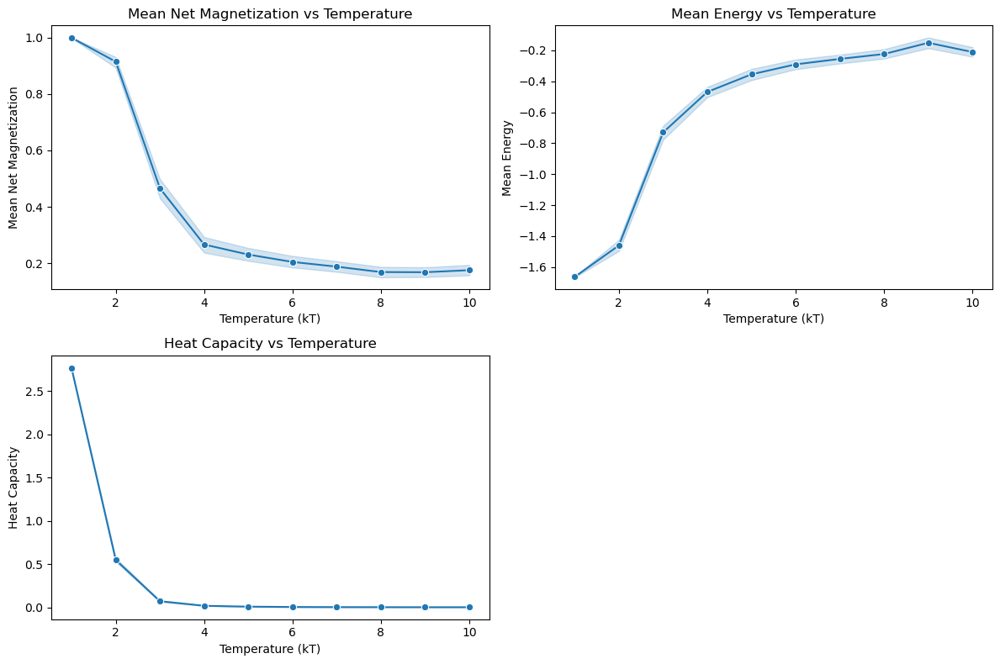

In [ ]:
# Plot the results using Seaborn
plt.figure(figsize=(12, 8))

plt.subplot(2, 2, 1)
sns.lineplot(x=simulation_results['temperature'], y=simulation_results['mean_net_magnetization'], marker='o')
plt.title('Mean Net Magnetization vs Temperature')
plt.xlabel('Temperature (kT)')
plt.ylabel('Mean Net Magnetization')

plt.subplot(2, 2, 2)
sns.lineplot(x=simulation_results['temperature'], y=simulation_results['mean_energy'], marker='o')
plt.title('Mean Energy vs Temperature')
plt.xlabel('Temperature (kT)')
plt.ylabel('Mean Energy')

plt.subplot(2, 2, 3)
sns.lineplot(x=simulation_results['temperature'], y=simulation_results['heat_capacity'], marker='o')
plt.title('Heat Capacity vs Temperature')
plt.xlabel('Temperature (kT)')
plt.ylabel('Heat Capacity')

plt.tight_layout()
plt.show()

In [4]:
import numpy as np
import matplotlib.pyplot as plt

def energyIsing2DInterdigitated(config, J,B):
    energyB, energyJ = 0, 0

    for row in range(len(config)):
        for col in range(len(config)):
            energyB += B * config[row, col]
            """if row>0: # Up
                energyJ += -J*config[row-1,col]*config[row,col] # Interior
            else:
                energyJ += -J*config[len(config)-1,col]*config[row,col] # Periodic boundary conditions
            if row<len(config)-1: # Down
                energyJ += -J*config[row+1,col]*config[row,col] # Interior
            else:
                energyJ += -J*config[0,col]*config[row,col] # Periodic boundary conditions
            if col>0: # Left
                if (col % 2) == 0:
                    energyJ += J*config[row,col-1]*config[row,col]
                else:
                    energyJ += -J*config[row,col-1]*config[row,col] # Interior
            else:
                if col % 2 == 0:
                    energyJ += J*config[row,len(config)-1]*config[row,col]
                else:
                    energyJ += -J*config[row,len(config)-1]*config[row,col] # Periodic boundary conditions
            if col<len(config)-1: # right
                if col % 2 == 0:
                    energyJ += J*config[row,col+1]*config[row,col]
                else:
                    energyJ += -J*config[row,col+1]*config[row,col] # Interior
            else:
                if col % 2 == 0:
                    energyJ += J*config[row,0]*config[row,col]
                else:
                    energyJ += -J*config[row,0]*config[row,col] # Periodic boundary conditions"""

            # Interactions within rows alternate between ferromagnetic and antiferromagnetic
            if row % 2 == 0:
                energyJ += J * config[row, col] * config[row, (col + 1) % len(config)]
            else:
                energyJ += -J * config[row, col] * config[row, (col + 1) % len(config)]

            # Ferromagnetic interactions between rows
            energyJ += -J * config[row, col] * config[(row + 1) % len(config), col]
    # print(energyJ)
    return energyB + energyJ

def energyIsing2DPBC(config, J, B):
    """energy of an Ising model with Periodic Boundary Conditions"""
    energyB = 0
    energyJ = 0
    J=-1
    for row in range(len(config)):
        for col in range(len(config)):
            energyB = config[row, col] * B
            # Up (PBC for rows)
            energyJ += J * config[(row - 1) % len(config), col] * config[row, col]

            # Down (PBC for rows)
            energyJ += J * config[(row + 1) % len(config), col] * config[row, col]

            # Alternating interactions within rows
            if col % 2 == 0:
                J_row = 1
            else:
                J_row = -1

            # Left (PBC for columns)
            if col > 0:
                energyJ += J_row * config[row, col - 1] * config[row, col]
            else:
                energyJ += J_row * config[row, len(config) - 1] * config[row, col]

            # Right (PBC for columns)
            if col < len(config) - 1:
                energyJ += J_row * config[row, col + 1] * config[row, col]
            else:
                energyJ += J_row * config[row, 0] * config[row, col]

    return energyB + (energyJ / 2)  # Remove double counting and return final result
def MCstepPBC(kT, J, B, config):
    """MC step for Periodic Ising Model with alternating interactions in rows"""
    newConfig = config.copy()
    row, col = np.random.choice(range(len(config)), size=2, replace=True)

    Estart = config[row, col] * B

    # Up (PBC for rows)
    Estart += J * config[(row - 1) % len(config), col] * config[row, col]

    # Down (PBC for rows)
    Estart += J * config[(row + 1) % len(config), col] * config[row, col]

    # Alternating interactions within rows
    if col % 2 == 0:
        J_row = 1
    else:
        J_row = -1

    # Left (PBC for columns)
    if col > 0:
        Estart += J_row * config[row, col - 1] * config[row, col]
    else:
        Estart += J_row * config[row, len(config) - 1] * config[row, col]

    # Right (PBC for columns)
    if col < len(config) - 1:
        Estart += J_row * config[row, col + 1] * config[row, col]
    else:
        Estart += J_row * config[row, 0] * config[row, col]

    Eend = -Estart

    if Eend < Estart:  # did energy decrease?
        newConfig[row, col] *= -1  # Then flip the spin
    else:
        if np.random.random() <= np.exp(-(Eend - Estart) / kT):  # If a random number is less than the probability
            newConfig[row, col] *= -1  # Then flip the spin

    return newConfig  # Return the potentially altered array

def runMC_get_magnetization_energy(kT_values, J, B, nEquil, nDataCol, sampleInterval, config, MCstepFunction,EnergyFunction):
    """Function to run the Ising model MC simulation and collect net magnetization and mean energy values."""
    results = []
    for kT in kT_values:
        Msamples = []
        Esamples = []
        newConfig = config.copy()
        for i in range(nEquil):
            newConfig = MCstepFunction(kT, J, B, newConfig)
        for i in range(nDataCol):
            newConfig = MCstepFunction(kT, J, B, newConfig)
            if i % sampleInterval == 0:
                Msamples.append(abs(netMagnetizationPerSpin(newConfig)))
                #Esamples.append(energyFunction(newConfig, J, B))
        Msamples = np.array(Msamples)
        #Esamples = np.array(Esamples)
        results.append((kT, Msamples.mean(), Msamples.std(), 
                        # Esamples.mean() / len(config)2, Esamples.std() / len(config)2
                       ))
    return results
def runInterdigitatedSimulation(temperature_range, equilibration_steps, data_collection_steps, sample_interval, lattice_size):
    """
    Run a Monte Carlo simulation for the interdigitated Ising Model.

    Parameters:
    - temperature_range (numpy.ndarray): Array of temperatures to simulate.
    - equilibration_steps (int): Number of equilibration steps.
    - data_collection_steps (int): Number of steps to collect data.
    - sample_interval (int): Interval at which to collect data.
    - lattice_size (int): Size of the 2D lattice.

    Returns:
    dict: Results of the simulation, including temperature, mean net magnetization, and magnetic susceptibility.
    """
    results = {'temperature': [], 'mean_net_magnetization': [], 'magnetic_susceptibility': []}

    for kT in temperature_range:
        print(f"Running simulation for temperature kT={kT}")

        # Initial configuration
        config = np.random.choice([-1, 1], size=(lattice_size, lattice_size))

        # Equilibration steps
        for _ in range(equilibration_steps):
            config = MCstepPBC(kT, -1,0, config)

        # Data collection steps
        net_magnetization_samples = []
        for i in range(data_collection_steps):
            config = MCstepPBC(kT, -1, 0, config)
            if i % sample_interval == 0:
                net_magnetization_samples.append(np.sum(config))

        mean_net_magnetization = np.mean(net_magnetization_samples)
        magnetic_susceptibility = np.var(net_magnetization_samples) / (kT *1.38e-23)* (lattice_size**2)

        results['temperature'].append(kT)
        results['mean_net_magnetization'].append(mean_net_magnetization)
        results['magnetic_susceptibility'].append(magnetic_susceptibility)

    return results

In [4]:
# Run the simulation
temperature_range_interdigitated = np.linspace(1, 4, 10)
equilibration_steps_interdigitated = 5000000
data_collection_steps_interdigitated = 20000
sample_interval_interdigitated = 100
lattice_size_interdigitated = 10
checkerboardConfig = np.array([[(-1)**(row+col) for row in range(10)] for col in range(10)])
kbT_values = np.linspace(1, 4, 20)
mc = []
hc = []
ms = []
for Temp in temperature_range_interdigitated:
    results = runMC(Temp, -1, 0, 1000000, 20000, 1000, checkerboardConfig, MCstepPBC, energyIsing2DPBC)
    mc.append(results[0]) 
    hc.append(results[1]) 
    ms.append(results[2]) 
# results3 = runMC(3, -1, 0, 10000, 200000, 1000, config, MCstepPBC, energyIsing2DPBC)
# results2 = runMC(2, -1, 0, 10000, 200000, 1000, config, MCstepPBC, energyIsing2DPBC)
# results1 = runMC(1, -1, 0, 10000, 200000, 1000, config, MCstepPBC, energyIsing2DPBC)


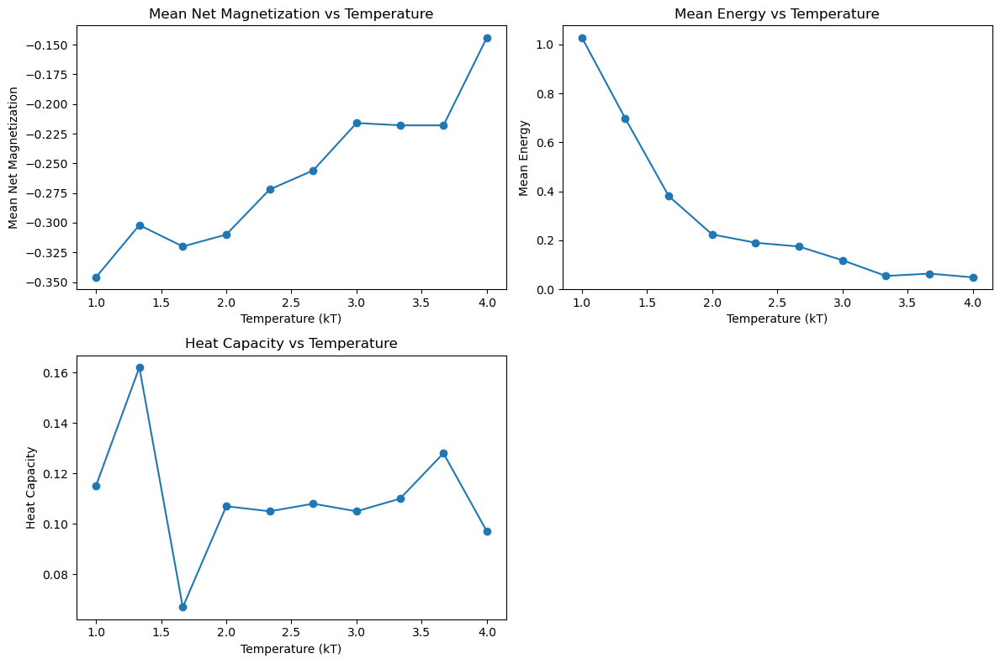

In [5]:
# Plot the results using Seaborn
import seaborn as sns
plt.figure(figsize=(12, 8))

plt.subplot(2, 2, 1)
plt.plot(temperature_range_interdigitated, mc, marker='o')
plt.title('Mean Net Magnetization vs Temperature')
plt.xlabel('Temperature (kT)')
plt.ylabel('Mean Net Magnetization')

plt.subplot(2, 2, 2)
plt.plot(temperature_range_interdigitated, hc, marker='o')
plt.title('Mean Energy vs Temperature')
plt.xlabel('Temperature (kT)')
plt.ylabel('Mean Energy')

plt.subplot(2, 2, 3)
plt.plot(temperature_range_interdigitated, ms, marker='o')
plt.title('Heat Capacity vs Temperature')
plt.xlabel('Temperature (kT)')
plt.ylabel('Heat Capacity')

plt.tight_layout()
plt.show()

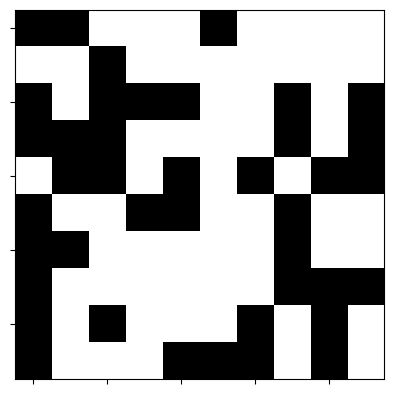

None


In [11]:
print(arrayPlot(results4[3]))

In [ ]:
# Plot the results
plt.figure(figsize=(12, 8))

plt.subplot(2, 1, 1)
plt.plot(simulation_results_interdigitated['temperature'], simulation_results_interdigitated['mean_net_magnetization'], marker='o')
plt.title('Mean Net Magnetization vs Temperature (Interdigitated System)')
plt.xlabel('Temperature (kT)')
plt.ylabel('Mean Net Magnetization')

plt.subplot(2, 1, 2)
plt.plot(simulation_results_interdigitated['temperature'], simulation_results_interdigitated['magnetic_susceptibility'], marker='o')
plt.title('Magnetic Susceptibility vs Temperature (Interdigitated System)')
plt.xlabel('Temperature (kT)')
plt.ylabel('Magnetic Susceptibility')

plt.tight_layout()

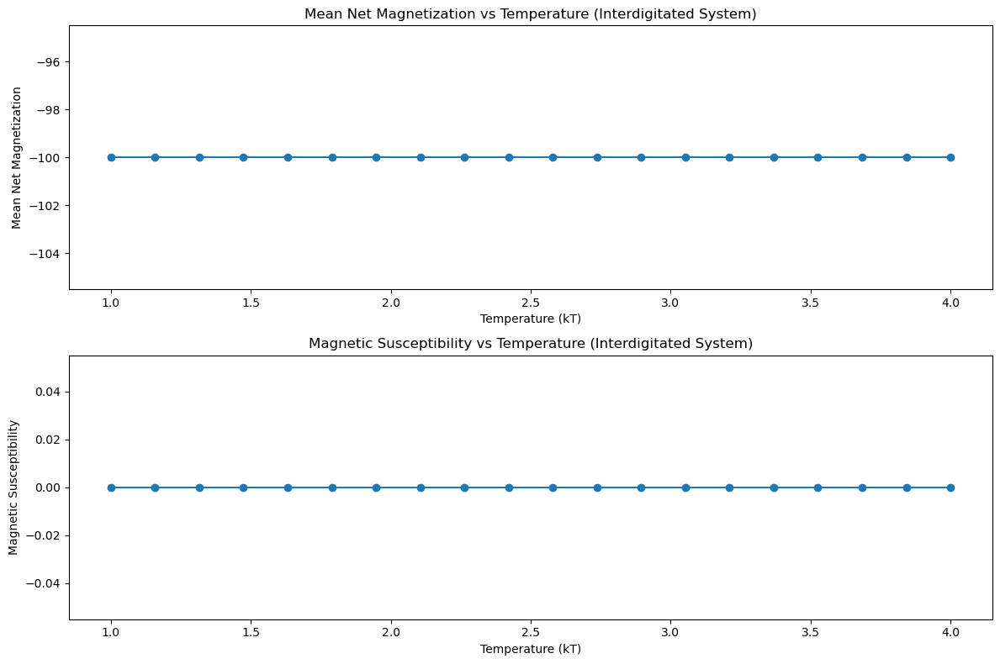

In [ ]:
# Plot the results
plt.figure(figsize=(12, 8))

plt.subplot(2, 1, 1)
plt.plot(simulation_results_interdigitated['temperature'], simulation_results_interdigitated['mean_net_magnetization'], marker='o')
plt.title('Mean Net Magnetization vs Temperature (Interdigitated System)')
plt.xlabel('Temperature (kT)')
plt.ylabel('Mean Net Magnetization')

plt.subplot(2, 1, 2)
plt.plot(simulation_results_interdigitated['temperature'], simulation_results_interdigitated['magnetic_susceptibility'], marker='o')
plt.title('Magnetic Susceptibility vs Temperature (Interdigitated System)')
plt.xlabel('Temperature (kT)')
plt.ylabel('Magnetic Susceptibility')

plt.tight_layout()

In [5]:
def runMCmovie_Ethan(kT,J,B, ax):
    """a python version of the runMCmovie function"""
    nSize = 10
    config1 = np.random.choice([-1, 1], size=(nSize, nSize))
    config = config1.copy()
    trajectory = []
    for _ in range(1500):
        config = MCstepPBC(kT,J,B,config)
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        arrayplot = [ax.imshow(config,cmap='Greys',
                               vmin=-1,vmax=1, animated=True)]
        trajectory.append(arrayplot)
    return trajectory #a list of arrayplot outputs

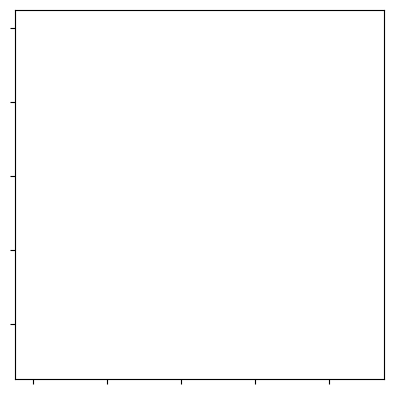

In [6]:
import matplotlib.animation as animation
from matplotlib import rc
rc('animation', html='jshtml')
fig, ax = plt.subplots()
images = runMCmovie_Ethan(1.25,-1,0, ax)
ani = animation.ArtistAnimation(fig, images, interval=1000/50, blit=True,repeat_delay=500)

In [7]:
ani